# Heart Disease Xboost

Cargamos los datos

In [1]:
import pandas as pd
ds_path = "../datasets/dataset-1/plant_health_data.csv"
df = pd.read_csv(ds_path)


In [2]:
df.head()

,Timestamp,Plant_ID,Soil_Moisture,Ambient_Temperature,Soil_Temperature,Humidity,Light_Intensity,Soil_pH,Nitrogen_Level,Phosphorus_Level,Potassium_Level,Chlorophyll_Content,Electrochemical_Signal,Plant_Health_Status
0,2024-10-03 10:54:53.407995,1,27.521109,22.240245,21.900435,55.291904,556.172805,5.581955,10.003650,45.806852,39.076199,35.703006,0.941402,High Stress
1,2024-10-03 16:54:53.407995,1,14.835566,21.706763,18.680892,63.949181,596.136721,7.135705,30.712562,25.394393,17.944826,27.993296,0.164899,High Stress
2,2024-10-03 22:54:53.407995,1,17.086362,21.180946,15.392939,67.837956,591.124627,5.656852,29.337002,27.573892,35.706530,43.646308,1.081728,High Stress
3,2024-10-04 04:54:53.407995,1,15.336156,22.593302,22.778394,58.190811,241.412476,5.584523,16.966621,26.180705,26.257746,37.838095,1.186088,High Stress
4,2024-10-04 10:54:53.407995,1,39.822216,28.929001,18.100937,63.772036,444.493830,5.919707,10.944961,37.898907,37.654483,48.265812,1.609805,High Stress


Exploramos los datos

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1200 entries, 0 to 1199
Data columns (total 14 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Timestamp               1200 non-null   object 
 1   Plant_ID                1200 non-null   int64  
 2   Soil_Moisture           1200 non-null   float64
 3   Ambient_Temperature     1200 non-null   float64
 4   Soil_Temperature        1200 non-null   float64
 5   Humidity                1200 non-null   float64
 6   Light_Intensity         1200 non-null   float64
 7   Soil_pH                 1200 non-null   float64
 8   Nitrogen_Level          1200 non-null   float64
 9   Phosphorus_Level        1200 non-null   float64
 10  Potassium_Level         1200 non-null   float64
 11  Chlorophyll_Content     1200 non-null   float64
 12  Electrochemical_Signal  1200 non-null   float64
 13  Plant_Health_Status     1200 non-null   object 
dtypes: float64(11), int64(1), object(2)
memo

Se observan tipos de datos que pueden ser ajustados

Observamos los valores unicos de las variables categóricas

In [4]:
from utils.extra import convert_bolean_columns
convert_bolean_columns(df)
df["Plant_Health_Status"] = df["Plant_Health_Status"].astype("category")
from datetime import datetime
def _convert_date(x):
    if pd.isna(x) or pd.isnull(x):
        return x
    try:
        return datetime.strptime(x, "%Y-%m-%dt%H:%M:%S%z")
    except Exception:
        
        return x

df["Timestamp"] = pd.to_datetime(df["Timestamp"].apply(_convert_date), utc=True)
from utils.extra import get_categoric_columns
categoric_columns = get_categoric_columns(df)
for i in categoric_columns:
    print(i)
    print(df[i].unique())

Plant_Health_Status
['High Stress', 'Moderate Stress', 'Healthy']
Categories (3, object): ['Healthy', 'High Stress', 'Moderate Stress']


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1200 entries, 0 to 1199
Data columns (total 14 columns):
 #   Column                  Non-Null Count  Dtype              
---  ------                  --------------  -----              
 0   Timestamp               1200 non-null   datetime64[ns, UTC]
 1   Plant_ID                1200 non-null   int64              
 2   Soil_Moisture           1200 non-null   float64            
 3   Ambient_Temperature     1200 non-null   float64            
 4   Soil_Temperature        1200 non-null   float64            
 5   Humidity                1200 non-null   float64            
 6   Light_Intensity         1200 non-null   float64            
 7   Soil_pH                 1200 non-null   float64            
 8   Nitrogen_Level          1200 non-null   float64            
 9   Phosphorus_Level        1200 non-null   float64            
 10  Potassium_Level         1200 non-null   float64            
 11  Chlorophyll_Content     1200 non-null   flo

Continuamos con la exploración de los datos

Visualizamos la cabecera, luego las últimas entradas

In [6]:
df.tail(10)

,Timestamp,Plant_ID,Soil_Moisture,Ambient_Temperature,Soil_Temperature,Humidity,Light_Intensity,Soil_pH,Nitrogen_Level,Phosphorus_Level,Potassium_Level,Chlorophyll_Content,Electrochemical_Signal,Plant_Health_Status
1190,2024-10-30 22:54:53.493508+00:00,10,21.101544,21.224523,20.443019,47.412024,330.108453,5.525475,33.288512,44.855238,21.087155,40.313722,0.983936,Moderate Stress
1191,2024-10-31 04:54:53.493508+00:00,10,28.329225,25.535363,22.747076,53.096940,424.438666,7.130092,15.293437,26.674986,37.763359,26.767146,1.386956,Moderate Stress
1192,2024-10-31 10:54:53.493508+00:00,10,29.525784,29.379422,23.521934,41.450049,305.967021,6.219658,36.625391,22.921366,14.312771,49.876819,1.284777,Moderate Stress
1193,2024-10-31 16:54:53.493508+00:00,10,11.790436,21.891448,22.466868,46.781881,859.507205,6.026423,37.320244,45.480831,29.543646,31.522679,1.660737,High Stress
1194,2024-10-31 22:54:53.493508+00:00,10,31.285269,27.780701,15.601218,41.615729,434.770317,6.775306,49.803127,23.751623,18.199599,30.070609,1.636535,Healthy
1195,2024-11-01 04:54:53.493508+00:00,10,29.665780,27.605285,15.381699,54.668196,650.536854,5.715289,29.993107,14.914470,21.560747,24.273224,0.714553,Moderate Stress
1196,2024-11-01 10:54:53.493508+00:00,10,15.490782,22.108112,15.221033,61.243143,768.760787,5.958957,45.258678,25.216248,31.940717,30.930676,1.448029,High Stress
1197,2024-11-01 16:54:53.493508+00:00,10,23.495723,21.680240,15.499764,40.693671,293.643366,7.419157,38.351189,48.656078,28.473233,38.324484,0.880019,Moderate Stress
1198,2024-11-01 22:54:53.493508+00:00,10,30.971675,23.019488,21.934918,41.387107,492.952014,5.855767,49.402550,23.843971,19.750042,46.027529,0.344597,Healthy
1199,2024-11-02 04:54:53.493508+00:00,10,24.406357,25.724605,23.358573,47.505394,304.201566,6.122042,29.659287,34.372586,10.486062,41.977098,0.047541,Moderate Stress


Verificamos los valores descriptivos

In [7]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Plant_ID,1200.0,5.500000,2.873479,1.000000,3.000000,5.500000,8.000000,10.000000
Soil_Moisture,1200.0,25.106918,8.677725,10.000724,17.131893,25.168333,32.370231,39.993164
Ambient_Temperature,1200.0,23.999130,3.441561,18.001993,21.101766,23.889044,27.042634,29.990886
Soil_Temperature,1200.0,19.957794,2.932073,15.003710,17.353027,19.911473,22.596851,24.995929
Humidity,1200.0,54.853165,8.784916,40.028758,47.019694,54.692069,62.451053,69.968871
Light_Intensity,1200.0,612.637265,228.318853,200.615482,416.878983,617.240221,811.474690,999.856262
Soil_pH,1200.0,6.524102,0.581755,5.507392,6.026042,6.540524,7.030039,7.497823
Nitrogen_Level,1200.0,30.106751,11.514396,10.003650,20.249774,30.138590,40.184737,49.951136
Phosphorus_Level,1200.0,30.264484,11.466846,10.017690,20.894445,30.019385,40.131459,49.980700
Potassium_Level,1200.0,30.112088,11.668085,10.000606,19.585561,30.495054,40.108296,49.981945


In [8]:
df.describe(include='category').T

,count,unique,top,freq
Plant_Health_Status,1200,3,High Stress,500


## Identificación de valores nulos y outliers

In [22]:
duplicated = df.duplicated().sum()
print(f"Registros duplicados en df: {duplicated}")

Registros duplicados en df: 0


no observamos duplicados

Ahora valores nulos

In [9]:
from utils.extra import get_nulll_data_info
get_nulll_data_info(df)

,datos sin NAs en q,Na en q,Na en %
Timestamp,1200,0,0.0
Plant_ID,1200,0,0.0
Soil_Moisture,1200,0,0.0
Ambient_Temperature,1200,0,0.0
Soil_Temperature,1200,0,0.0
Humidity,1200,0,0.0
Light_Intensity,1200,0,0.0
Soil_pH,1200,0,0.0
Nitrogen_Level,1200,0,0.0
Phosphorus_Level,1200,0,0.0


No existen valores nulos

Ahora verificamos los outliers

In [10]:
from utils.extra import get_outliers_data
get_outliers_data(df)

,Plant_ID,Soil_Moisture,Ambient_Temperature,Soil_Temperature,Humidity,Light_Intensity,Soil_pH,Nitrogen_Level,Phosphorus_Level,Potassium_Level,Chlorophyll_Content,Electrochemical_Signal
N° Outliers,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
% Outliers,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
Lim. mix,-4.5,-5.725614,12.190464,9.487290,23.872655,-175.014577,4.520048,-9.652671,-7.961075,-11.198542,5.309419,-0.989759
Lim. max,15.5,55.227738,35.953936,30.462587,85.598093,1403.368250,8.536033,70.087183,68.986979,70.892399,64.386568,2.950883


Visualizamos las gráficas de cajas de nuestras columnas

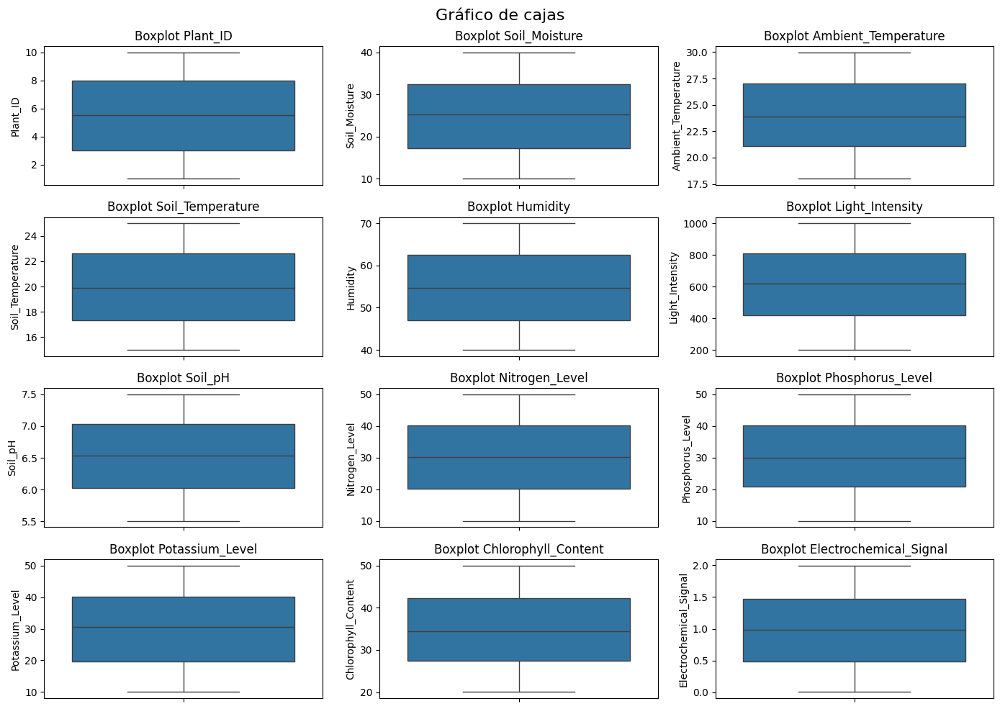

In [11]:
from utils.extra import graph_boxplot, get_numeric_columns
graph_boxplot(df, columns=get_numeric_columns(df))

No se observan outliers

Ahora veremos las caracteristicas descriptivas de las variables númericas

In [12]:
df.describe()

,Plant_ID,Soil_Moisture,Ambient_Temperature,Soil_Temperature,Humidity,Light_Intensity,Soil_pH,Nitrogen_Level,Phosphorus_Level,Potassium_Level,Chlorophyll_Content,Electrochemical_Signal
count,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000,1200.000000
mean,5.500000,25.106918,23.999130,19.957794,54.853165,612.637265,6.524102,30.106751,30.264484,30.112088,34.749591,0.987764
std,2.873479,8.677725,3.441561,2.932073,8.784916,228.318853,0.581755,11.514396,11.466846,11.668085,8.766995,0.575116
min,1.000000,10.000724,18.001993,15.003710,40.028758,200.615482,5.507392,10.003650,10.017690,10.000606,20.025511,0.002376
25%,3.000000,17.131893,21.101766,17.353027,47.019694,416.878983,6.026042,20.249774,20.894445,19.585561,27.463350,0.487982
50%,5.500000,25.168333,23.889044,19.911473,54.692069,617.240221,6.540524,30.138590,30.019385,30.495054,34.433427,0.981647
75%,8.000000,32.370231,27.042634,22.596851,62.451053,811.474690,7.030039,40.184737,40.131459,40.108296,42.232637,1.473142
max,10.000000,39.993164,29.990886,24.995929,69.968871,999.856262,7.497823,49.951136,49.980700,49.981945,49.990811,1.996116


In [13]:
from utils.extra import get_descriptive_statistics
get_descriptive_statistics(df)

,Plant_ID,Soil_Moisture,Ambient_Temperature,Soil_Temperature,Humidity,Light_Intensity,Soil_pH,Nitrogen_Level,Phosphorus_Level,Potassium_Level,Chlorophyll_Content,Electrochemical_Signal
min,1.000000,10.000724,18.001993,15.003710,40.028758,200.615482,5.507392,10.003650,10.017690,10.000606,20.025511,0.002376
max,10.000000,39.993164,29.990886,24.995929,69.968871,999.856262,7.497823,49.951136,49.980700,49.981945,49.990811,1.996116
mean,5.500000,25.106918,23.999130,19.957794,54.853165,612.637265,6.524102,30.106751,30.264484,30.112088,34.749591,0.987764
std,2.873479,8.677725,3.441561,2.932073,8.784916,228.318853,0.581755,11.514396,11.466846,11.668085,8.766995,0.575116
median,5.500000,25.168333,23.889044,19.911473,54.692069,617.240221,6.540524,30.138590,30.019385,30.495054,34.433427,0.981647
variation_coefficient,0.522451,0.345631,0.143404,0.146914,0.160153,0.372682,0.089170,0.382452,0.378888,0.387488,0.252291,0.582240


Ahora visualizaremos los histogramas de las diferentes columnas numéricas para entender mejor la distribución

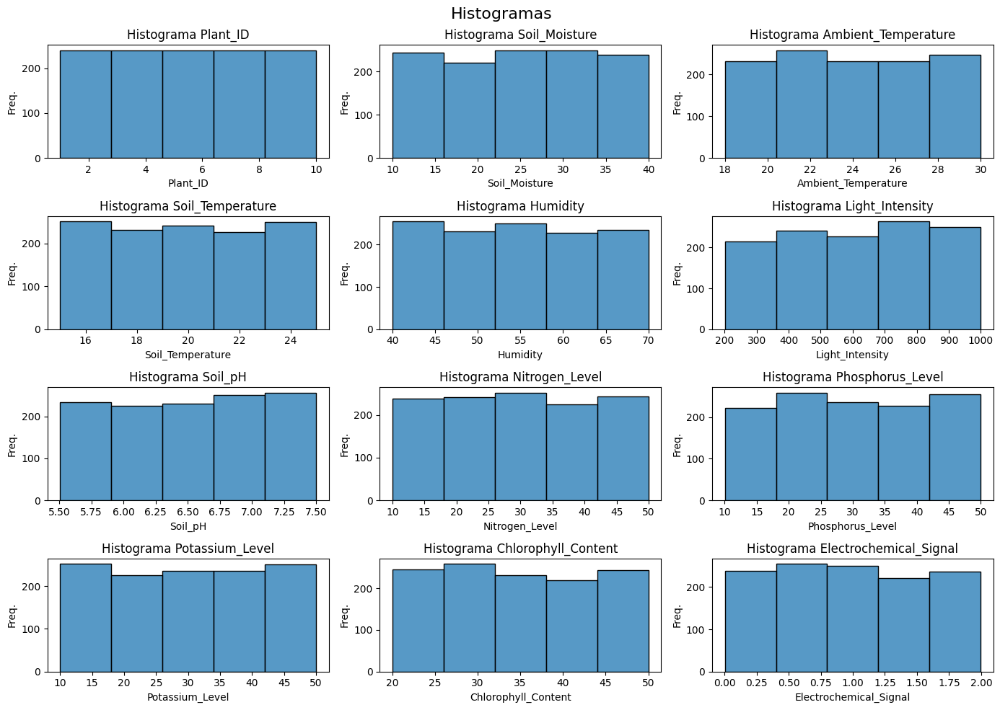

In [14]:
from utils.extra import graph_histogram
graph_histogram(df, get_numeric_columns(df))

No se observa nada fuera de lo normal en las distribuciones

Veremos las correlaciones entre las caracteristicas

In [15]:
from utils.extra import get_numeric_columns
numeric_columns = get_numeric_columns(df)
corr_matrix = df[numeric_columns].corr(method="pearson")
spearmann = df[numeric_columns].corr(method="spearman")
kendall = df[numeric_columns].corr(method="kendall")
corr_matrix

,Plant_ID,Soil_Moisture,Ambient_Temperature,Soil_Temperature,Humidity,Light_Intensity,Soil_pH,Nitrogen_Level,Phosphorus_Level,Potassium_Level,Chlorophyll_Content,Electrochemical_Signal
Plant_ID,1.000000,-0.034321,-0.029856,0.023195,-0.004697,0.008830,0.046939,-0.020165,-0.011265,0.016812,-0.008191,-0.005156
Soil_Moisture,-0.034321,1.000000,-0.009344,-0.026783,0.053876,-0.009343,-0.043502,-0.024752,0.019002,0.030804,0.039419,-0.010556
Ambient_Temperature,-0.029856,-0.009344,1.000000,0.037381,0.003921,-0.025289,-0.021229,-0.012223,-0.001462,0.011405,0.027442,0.007278
Soil_Temperature,0.023195,-0.026783,0.037381,1.000000,0.022697,0.004004,-0.025315,-0.033010,-0.039818,-0.025599,0.050740,-0.023506
Humidity,-0.004697,0.053876,0.003921,0.022697,1.000000,-0.023648,0.013627,-0.022661,-0.003064,0.012435,0.019202,0.007398
Light_Intensity,0.008830,-0.009343,-0.025289,0.004004,-0.023648,1.000000,0.008377,-0.012746,-0.040853,-0.029557,0.017122,-0.003094
Soil_pH,0.046939,-0.043502,-0.021229,-0.025315,0.013627,0.008377,1.000000,-0.006345,0.023200,0.011618,0.001404,-0.021791
Nitrogen_Level,-0.020165,-0.024752,-0.012223,-0.033010,-0.022661,-0.012746,-0.006345,1.000000,0.013319,0.007934,-0.045398,-0.003875
Phosphorus_Level,-0.011265,0.019002,-0.001462,-0.039818,-0.003064,-0.040853,0.023200,0.013319,1.000000,-0.022126,0.001347,-0.010935
Potassium_Level,0.016812,0.030804,0.011405,-0.025599,0.012435,-0.029557,0.011618,0.007934,-0.022126,1.000000,-0.010863,-0.013052


Ahora graficamos el mapa de calor de las correlaciones

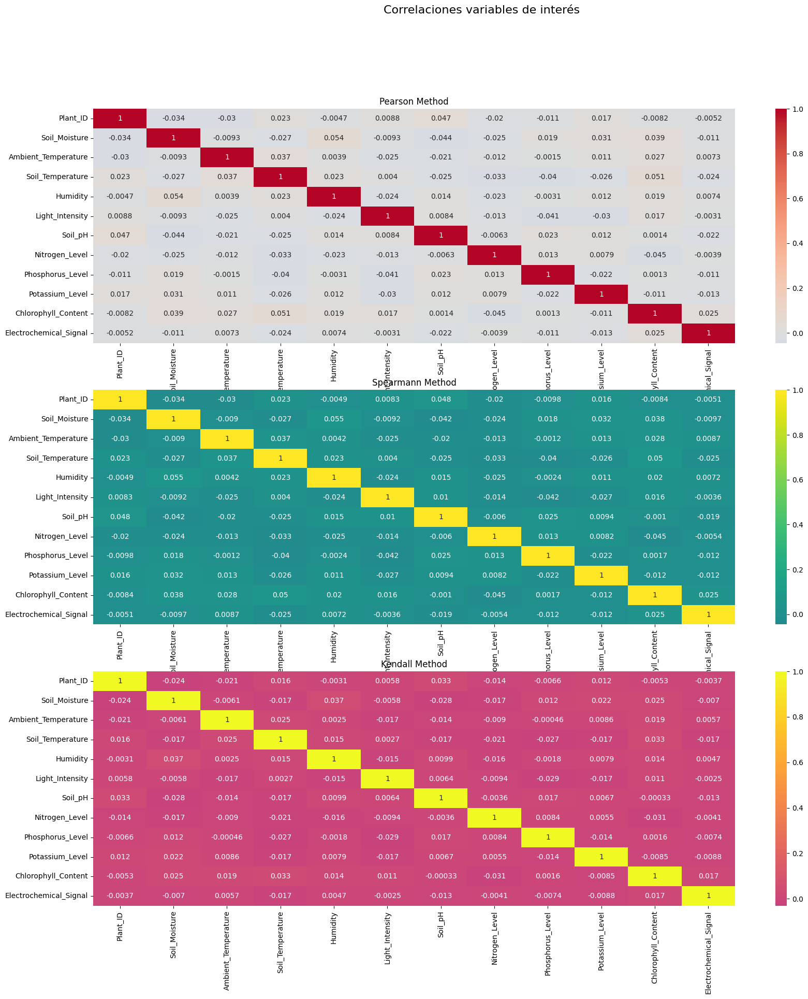

In [16]:
from utils.extra import graph_correlations
graph_correlations(corr_matrix, spearmann, kendall, "Correlaciones variables de interés", figsize= (20,20))

No se observan correlaciones entre las variables

Ahora observaremos la dispersión entre las variables

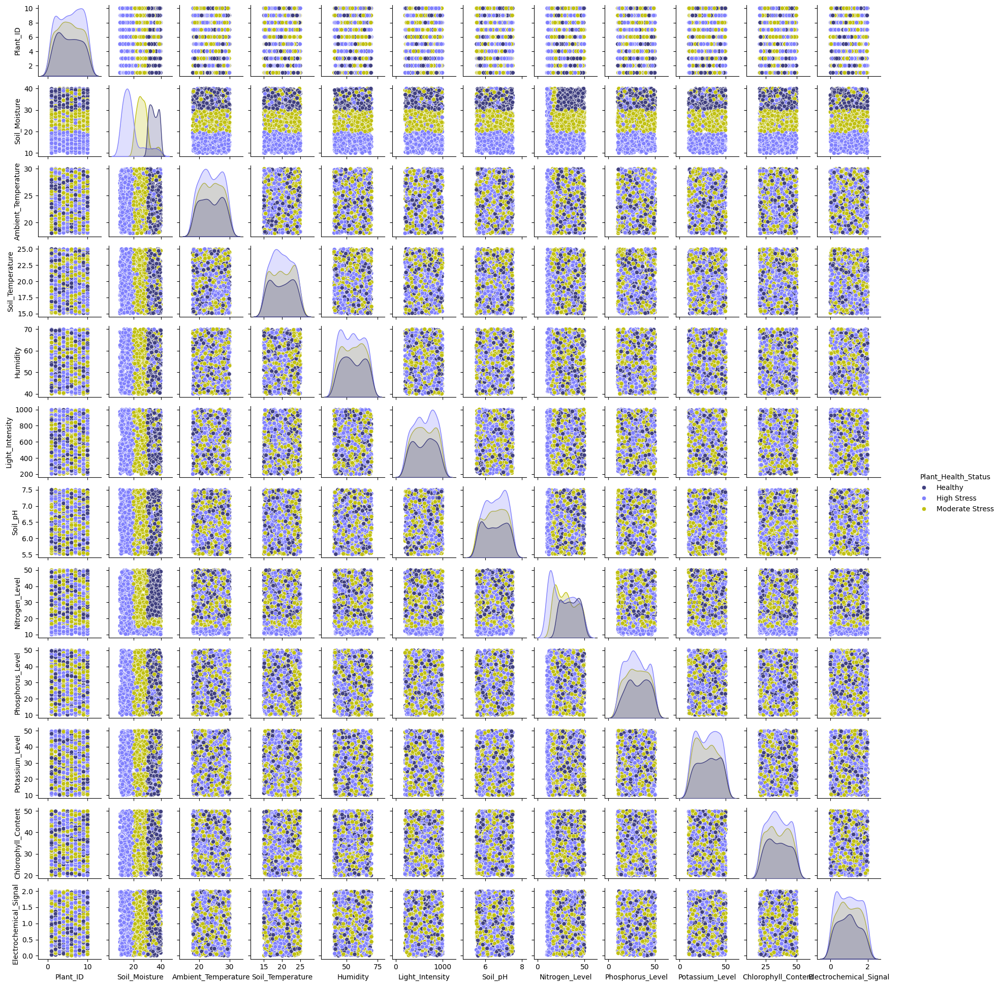

In [17]:
import matplotlib.pyplot as plt
import seaborn as sns
numeric_columns = get_numeric_columns(df)
palette = sns.color_palette("gist_stern", n_colors=3)
g = sns.pairplot(df[[*numeric_columns] + ["Plant_Health_Status"]], hue='Plant_Health_Status', height=1.2, diag_kind = 'kde', palette=palette)
g.figure.set_size_inches(20, 20)
plt.show()

Observamos que en algunas gráficas de dispersión existen patrones importantes

Ahora las observamos con más detalles

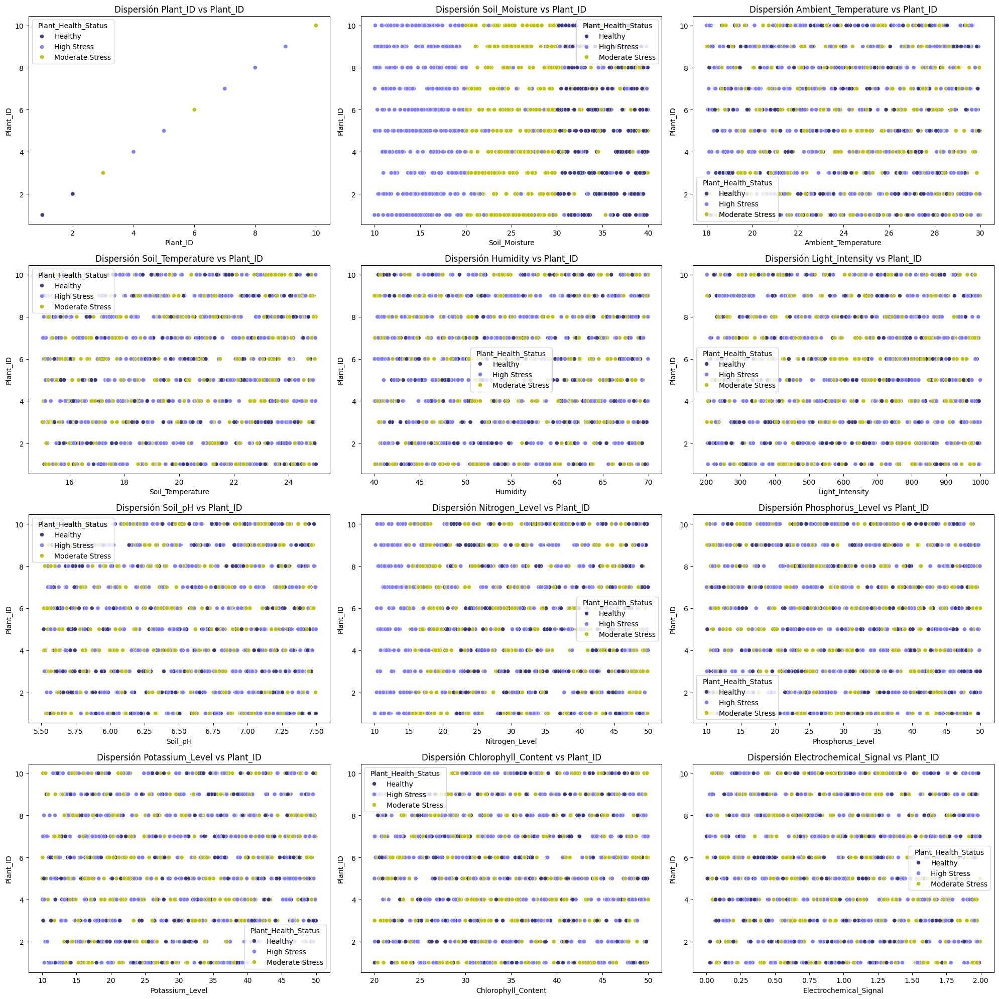

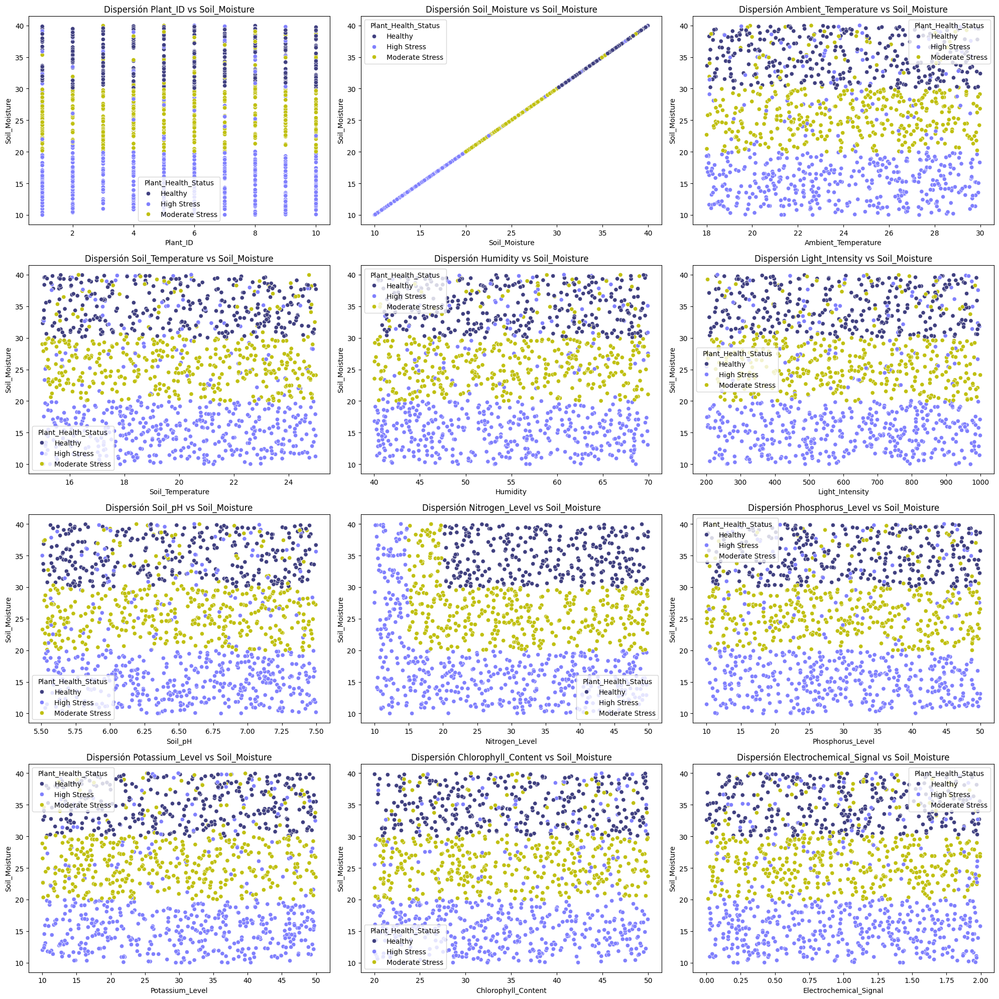

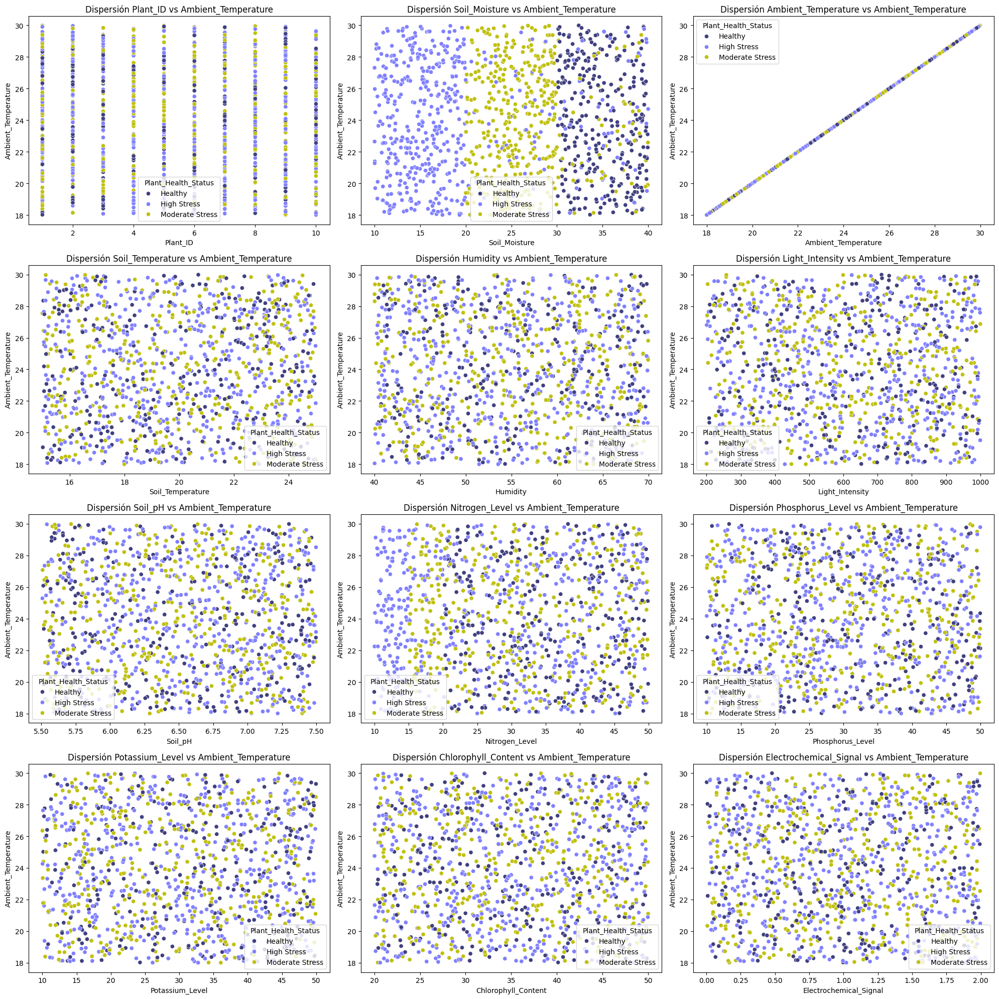

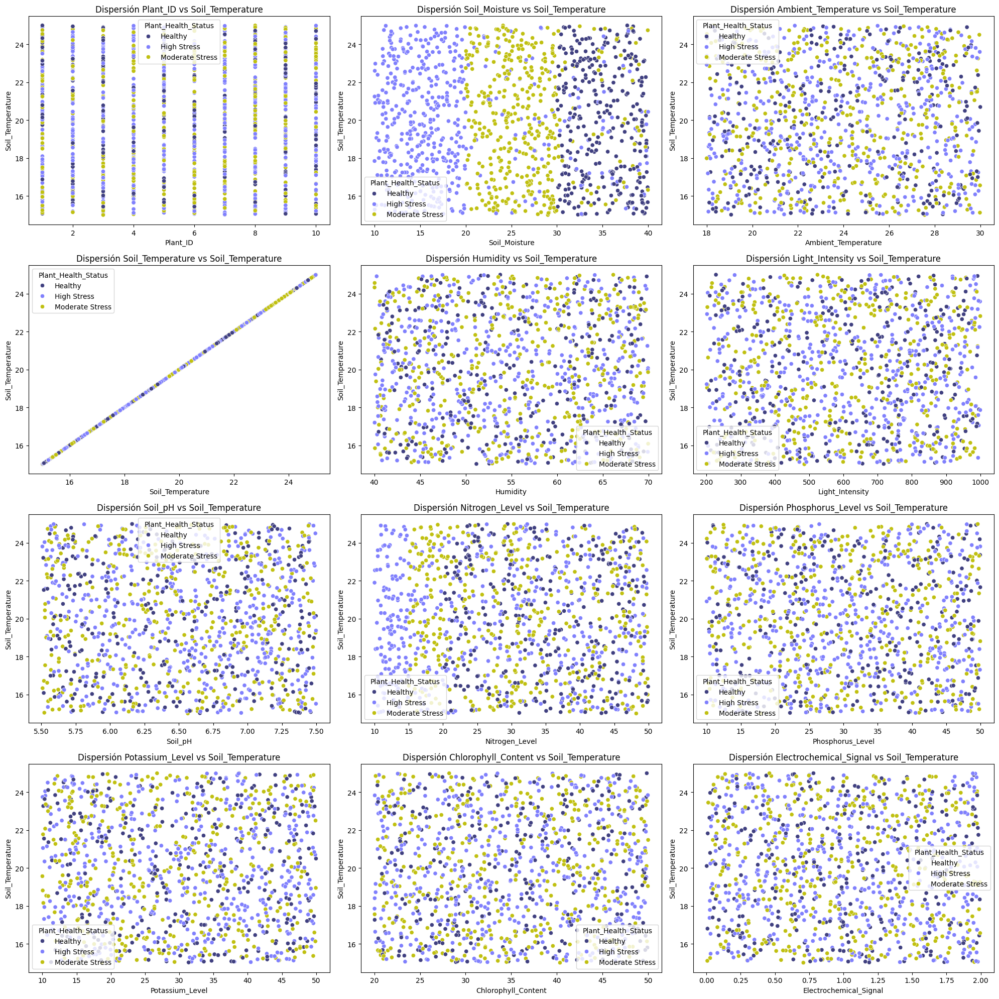

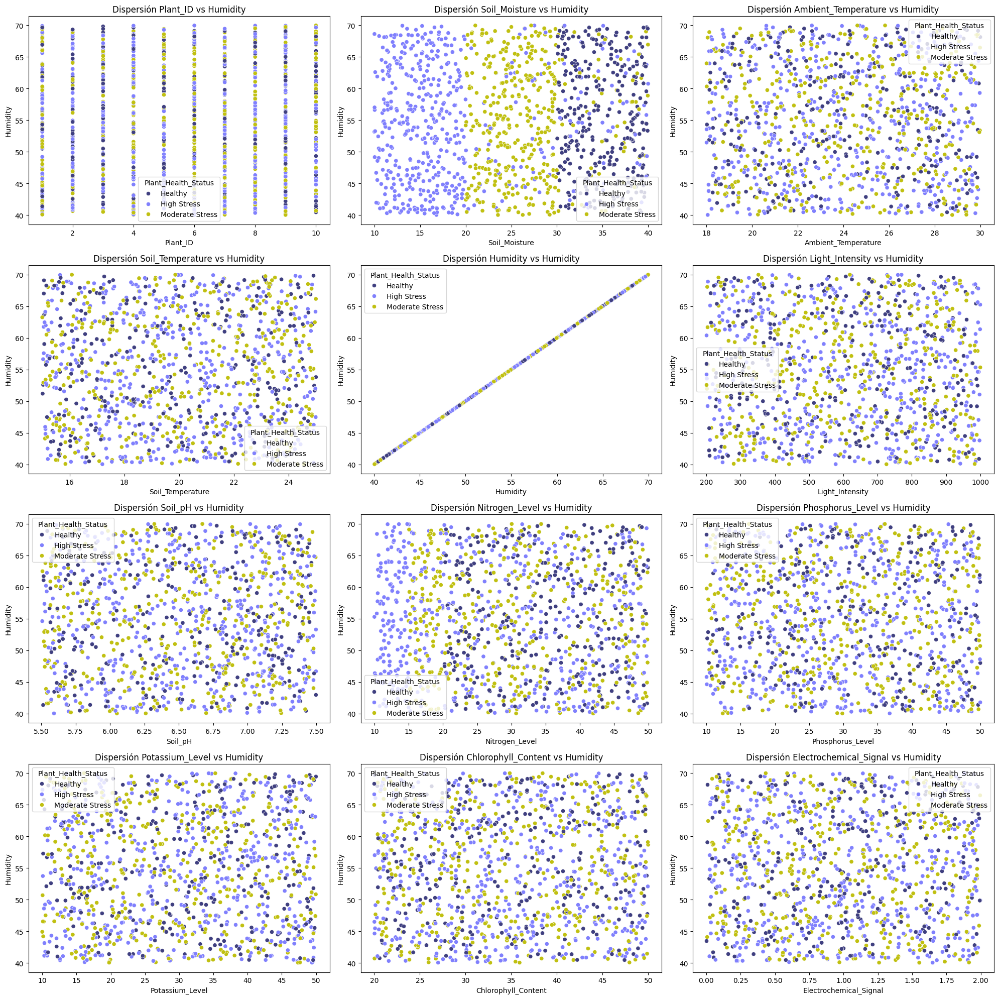

...

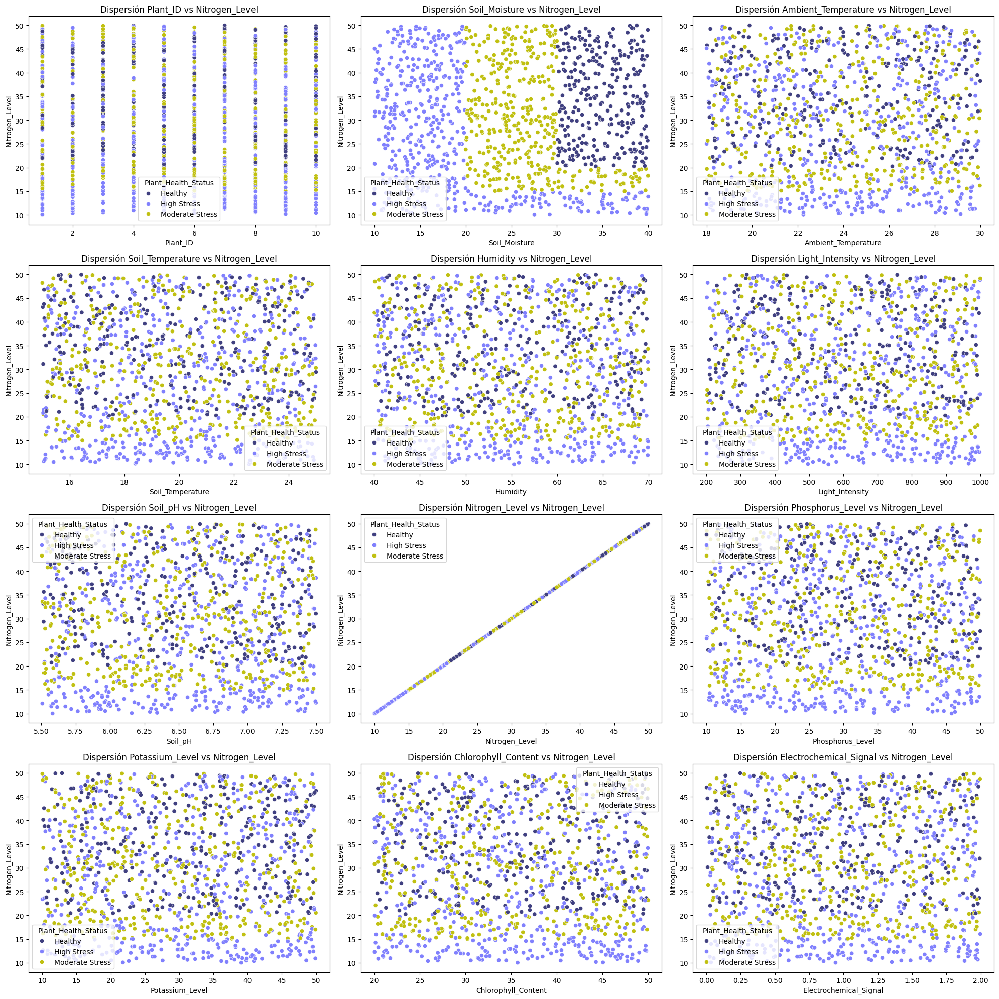

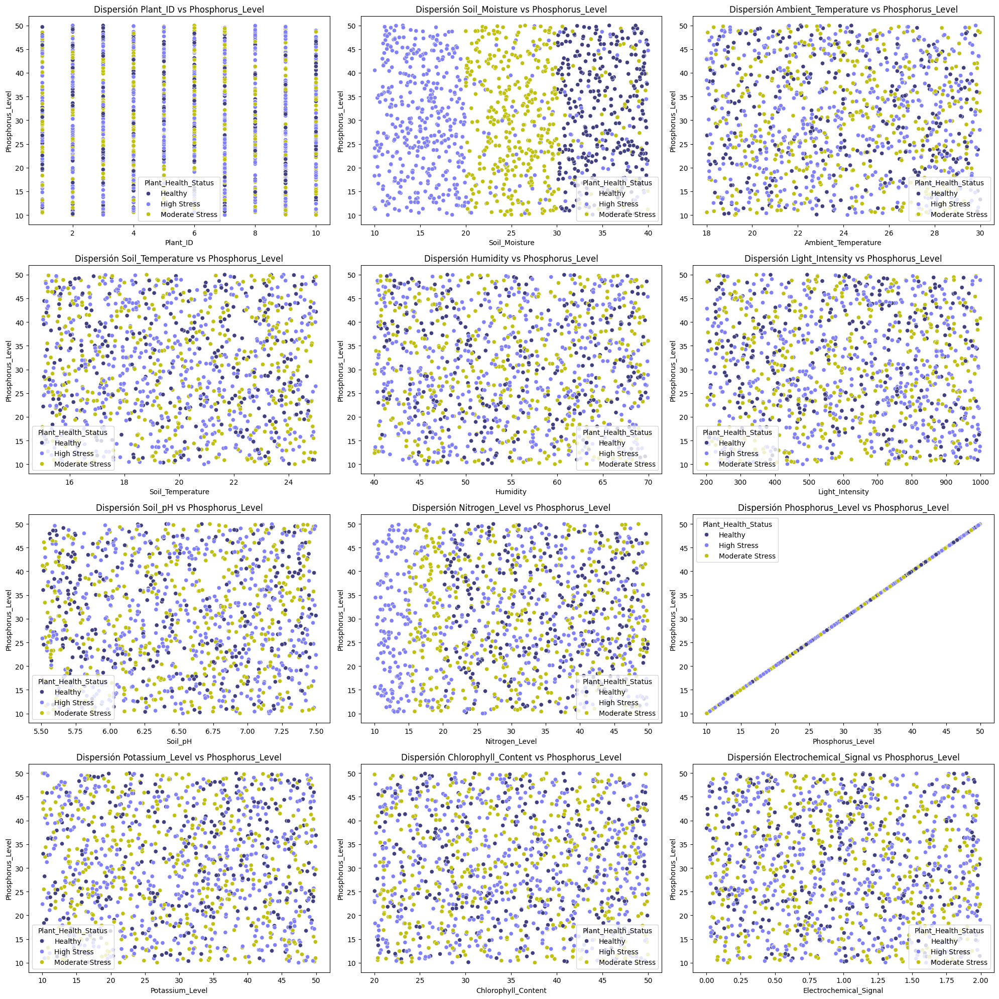

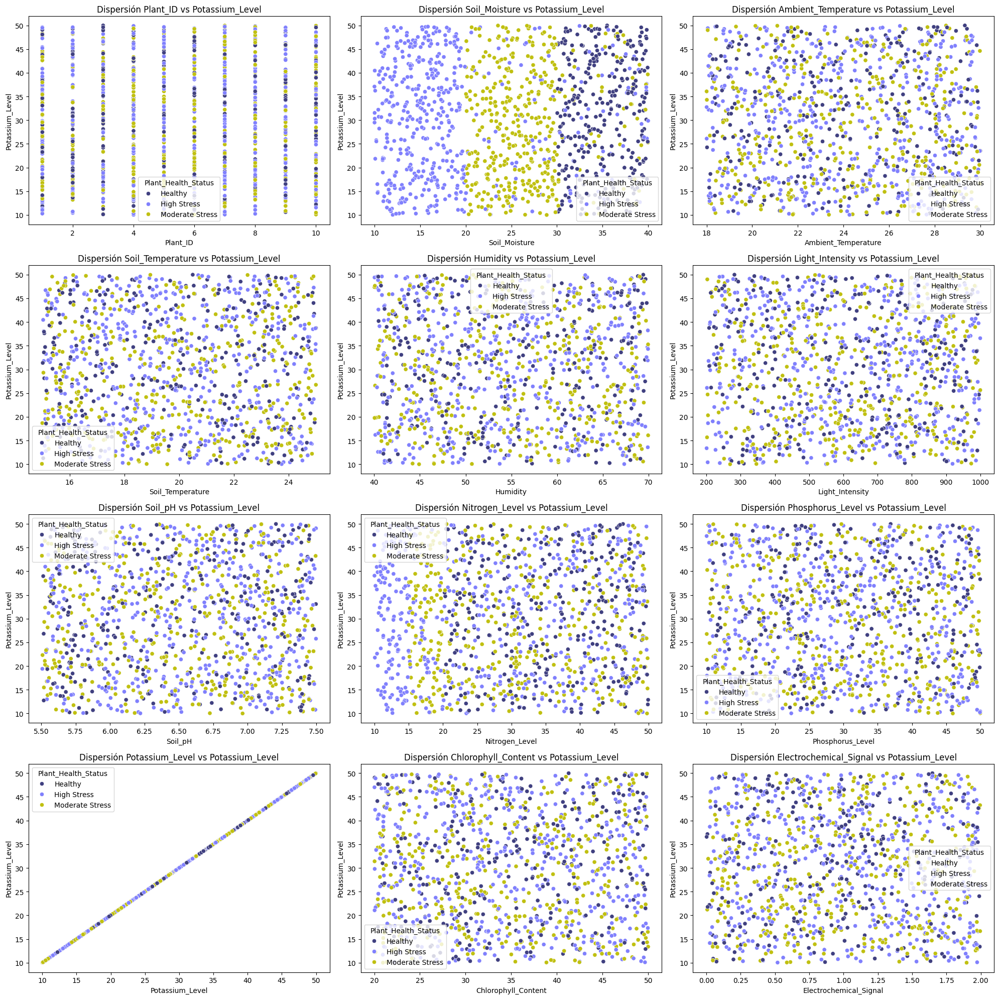

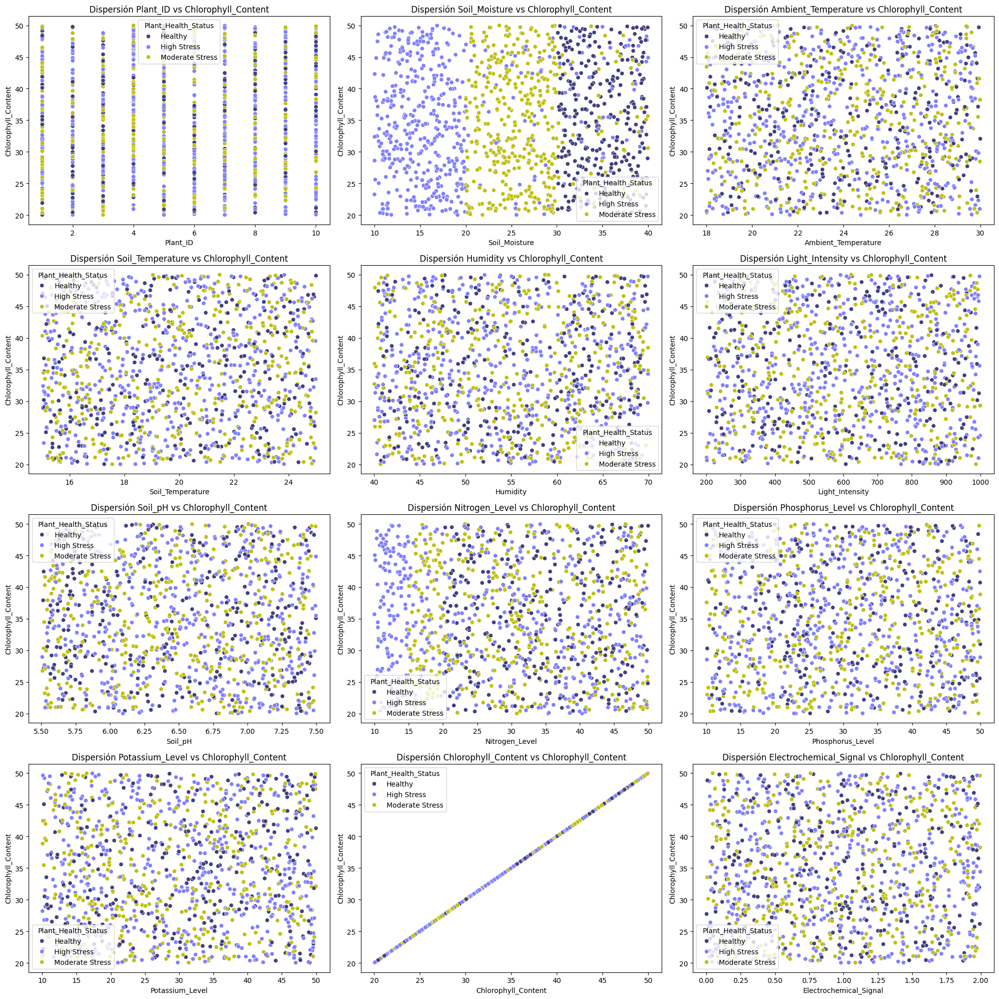

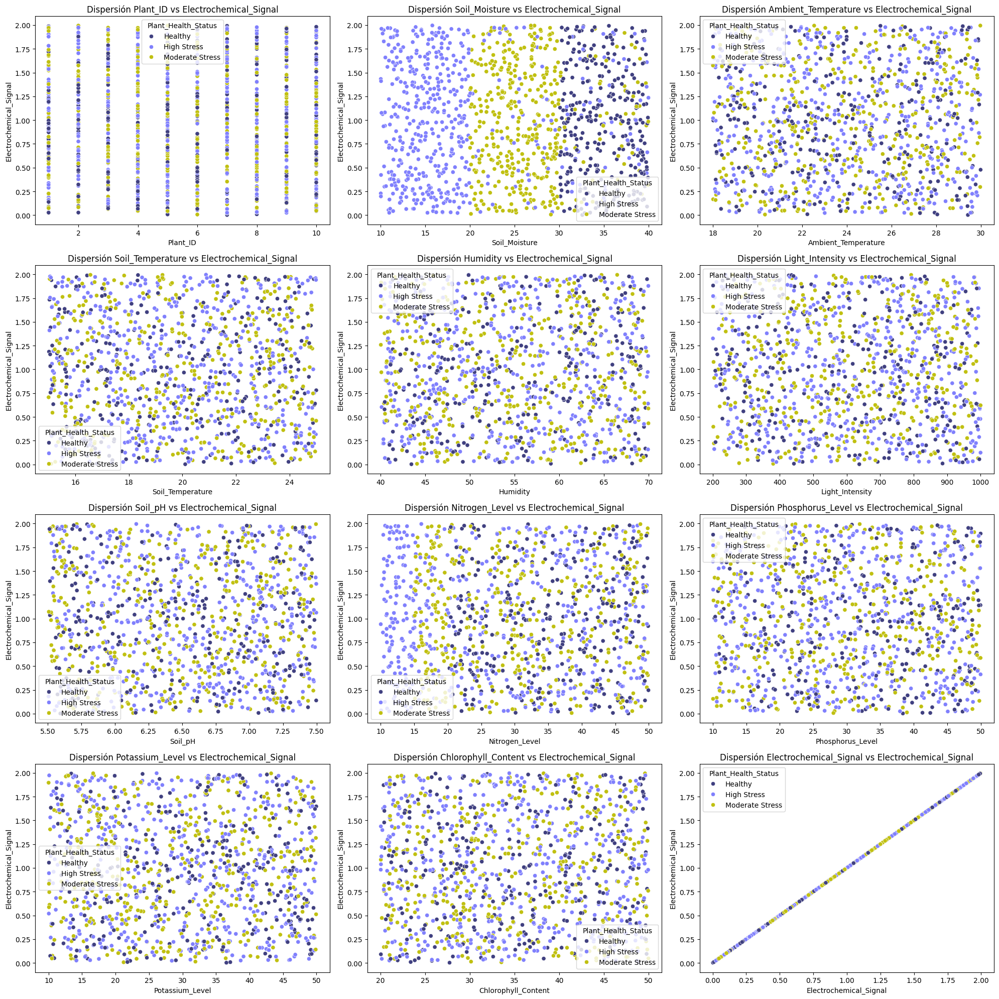

In [20]:
from utils.extra import graph_scaterplot
for i in numeric_columns:
    graph_scaterplot(df, numeric_columns, i, hue="Plant_Health_Status", palette=palette, figsize=(20,20))

En las gráficas de dispersión se observa que las variables soil moisture y nitrogen level tienen fuerte influencia en la salud de la planta

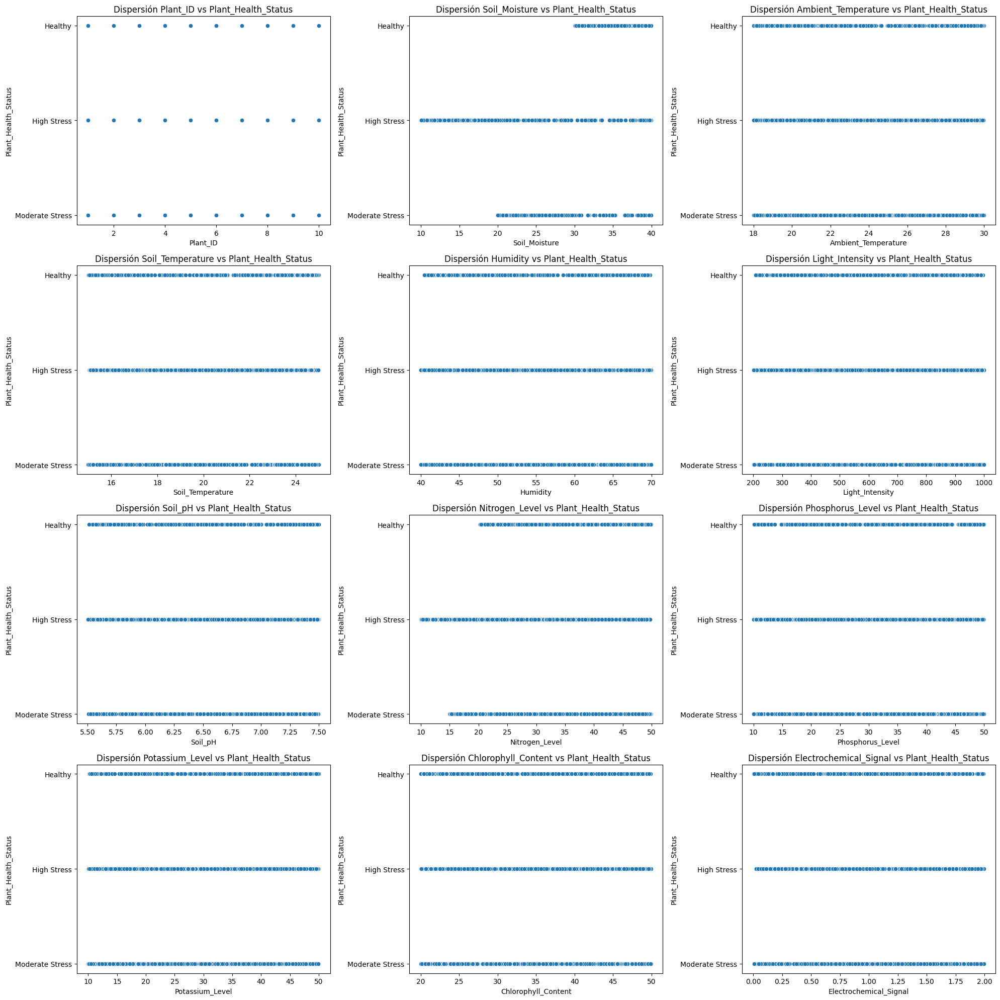

In [21]:
graph_scaterplot(df, numeric_columns, "Plant_Health_Status", figsize=(20,20))

En estas gráficas se observan que si observamos cada columna por separado, no se encuentra una relación directa con la salud de las plantas, solamente se observa para casos cómo nivel de nitrogeno y soil moisture

### Resumen

Según lo observado en este EDA, el dataset se encuentra bastante limpio, no encontramos valores nulos, duplicados ni outliers que deban ser eliminados.
En la observación inicial hemos encontrado que existen 2 variables importantes con mucha influencia sobre la salud de la planta
Los demás campos pueden ser analizados con herramientas más robustas más adelante